# SpatialMouse - Extract features

Requirements:
- `SpatialMouse_09_nuclei_seg.py`: segmentation of nuclei in all organs

In [1]:
## The following code ensures that all functions and init files are reloaded before executions.
%load_ext autoreload
%autoreload 2

In [2]:
#%gui qt

In [47]:
from cellpose import models
import torch

import numpy as np
import matplotlib.pyplot as plt
import scanpy as sc
import pandas as pd
import anndata
import seaborn as sns
from tqdm import tqdm
from glob import glob
import squidpy as sq
import gc
import cv2
from pathlib import Path
from skimage.measure import regionprops_table, regionprops
#import sfaira

## Import the custom library
import os
import sys
#module_path = os.path.abspath(os.path.join('/home/hpc/johannes.wirth/projects/DbitX_toolbox/'))
module_path = os.path.abspath(os.path.join("/lustre/groups/hpc/meier_lab/projects/git/DbitX_toolbox/"))

if module_path not in sys.path:
    sys.path.append(module_path)

import dbitx_funcs as db

In [4]:
plt.rcParams['figure.dpi'] = 80
plt.style.use('default')

In [5]:
data_dir = "/lustre/groups/hpc/meier_lab/projects/SpatialMouse/analysis/segmentation"

# Load data to generate ImageContainer

## Load segmentation masks

In [5]:
mask_files = glob(os.path.join(data_dir, "*.npy"))

In [6]:
mask_files

['/lustre/groups/hpc/meier_lab/projects/SpatialMouse/analysis/segmentation/segmasks_37_38_B1_dapi.npy',
 '/lustre/groups/hpc/meier_lab/projects/SpatialMouse/analysis/segmentation/segmasks_37_46_A2_dapi.npy',
 '/lustre/groups/hpc/meier_lab/projects/SpatialMouse/analysis/segmentation/segmasks_37_38_A3_dapi.npy',
 '/lustre/groups/hpc/meier_lab/projects/SpatialMouse/analysis/segmentation/segmasks_37_46_C1_dapi.npy',
 '/lustre/groups/hpc/meier_lab/projects/SpatialMouse/analysis/segmentation/segmasks_37_38_B3_dapi.npy',
 '/lustre/groups/hpc/meier_lab/projects/SpatialMouse/analysis/segmentation/segmasks_37_38_C1_dapi.npy',
 '/lustre/groups/hpc/meier_lab/projects/SpatialMouse/analysis/segmentation/segmasks_37_38_A1_dapi.npy',
 '/lustre/groups/hpc/meier_lab/projects/SpatialMouse/analysis/segmentation/segmasks_37_46_B3_dapi.npy',
 '/lustre/groups/hpc/meier_lab/projects/SpatialMouse/analysis/segmentation/segmasks_37_46_A1_dapi.npy',
 '/lustre/groups/hpc/meier_lab/projects/SpatialMouse/analysis/se

In [7]:
mask = np.load(mask_files[1])

## Get hq imaging data

In [8]:
hq_image_file = "/lustre/groups/hpc/meier_lab/projects/SpatialMouse/analysis/adata_filtered_unnormalized_hqimages.h5ad"

In [9]:
hq_adata = sc.read(hq_image_file)

In [10]:
hq_adata.uns['spatial'].keys()

dict_keys(['37_38_A1_dapi', '37_38_A2_dapi', '37_38_A3_bf', '37_38_A3_dapi', '37_38_A3_phalloidin', '37_38_B1_bf', '37_38_B1_dapi', '37_38_B1_phalloidin', '37_38_B2_bf', '37_38_B2_dapi', '37_38_B2_phalloidin', '37_38_B3_bf', '37_38_B3_dapi', '37_38_B3_phalloidin', '37_38_C1_bf', '37_38_C1_dapi', '37_38_C1_phalloidin', '37_46_A1_CD31', '37_46_A1_bf', '37_46_A1_dapi', '37_46_A1_phalloidin', '37_46_A2_CD31', '37_46_A2_bf', '37_46_A2_dapi', '37_46_A2_phalloidin', '37_46_A3_CD31', '37_46_A3_bf', '37_46_A3_dapi', '37_46_A3_phalloidin', '37_46_B1_CD31', '37_46_B1_bf', '37_46_B1_dapi', '37_46_B1_phalloidin', '37_46_B2_CD31', '37_46_B2_bf', '37_46_B2_dapi', '37_46_B2_phalloidin', '37_46_B3_CD31', '37_46_B3_bf', '37_46_B3_dapi', '37_46_B3_phalloidin', '37_46_C1_CD31', '37_46_C1_bf', '37_46_C1_dapi', '37_46_C1_phalloidin', '37_46_C2_CD31', '37_46_C2_bf', '37_46_C2_dapi', '37_46_C2_phalloidin', '37_46_C3_CD31', '37_46_C3_bf', '37_46_C3_dapi', '37_46_C3_phalloidin'])

# Generate imagecontainers of all images and segmentation masks

In [11]:
indices = hq_adata.obs['id'].unique()

In [12]:
containers = {}
for idx in indices:
    # check which mask to load
    img_keys = [elem for elem in hq_adata.uns['spatial'].keys() if idx in elem]
    mask_file = [elem for elem in mask_files if idx in elem][0]
    
    # load mask
    mask = np.load(mask_file)

    # create image container from mask
    image = sq.im.ImageContainer(mask, layer='segmented')

    # add images as multichannel image
    # imgs = [hq_adata.uns['spatial'][k]['images']['hires'][..., np.newaxis] for k in img_keys]
    # image.add_img(np.stack(imgs, axis=3), layer='image')

    # add images to container
    for img_key in img_keys:
        img = hq_adata.uns['spatial'][img_key]['images']['hires']
        label = img_key.split("_")[-1] # channel name

        # add empty z axis
        #img = img[..., np.newaxis]
        
        # convert to grayscale if necessary
        if len(img.shape) == 3:
            img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

        image.add_img(img, layer=label)
        
    containers[idx] = image

In [13]:
containers

{'37_38_A3': ImageContainer[shape=(20296, 20296), layers=['bf', 'dapi', 'phalloidin', 'segmented']],
 '37_38_B1': ImageContainer[shape=(20296, 20296), layers=['bf', 'dapi', 'phalloidin', 'segmented']],
 '37_38_B2': ImageContainer[shape=(20296, 20296), layers=['bf', 'dapi', 'phalloidin', 'segmented']],
 '37_38_B3': ImageContainer[shape=(20296, 20296), layers=['bf', 'dapi', 'phalloidin', 'segmented']],
 '37_38_C1': ImageContainer[shape=(20296, 20296), layers=['bf', 'dapi', 'phalloidin', 'segmented']],
 '37_46_A1': ImageContainer[shape=(20296, 20296), layers=['CD31', 'bf', 'dapi', 'phalloidin', 'segmented']],
 '37_46_A2': ImageContainer[shape=(20296, 20296), layers=['CD31', 'bf', 'dapi', 'phalloidin', 'segmented']],
 '37_46_A3': ImageContainer[shape=(20296, 20296), layers=['CD31', 'bf', 'dapi', 'phalloidin', 'segmented']],
 '37_46_B1': ImageContainer[shape=(20296, 20296), layers=['CD31', 'bf', 'dapi', 'phalloidin', 'segmented']],
 '37_46_B2': ImageContainer[shape=(20296, 20296), layers=['

## Save image containers

Image containers are saved as zarr stores which are folders that contain the required data.

In [172]:
container_dir = os.path.join(data_dir, "imagecontainers")

Path(container_dir).mkdir(parents=True, exist_ok=True)

for key, image in containers.items():
    savedir = os.path.join(container_dir, key)
    image.save(savedir)

# Load image containers

In [6]:
container_dir = os.path.join(data_dir, "imagecontainers")
stores = glob(os.path.join(container_dir, "*"))

containers = {store.split(os.sep)[-1]: sq.im.ImageContainer.load(store) for store in stores}

## Plot examples for segmentation of each image

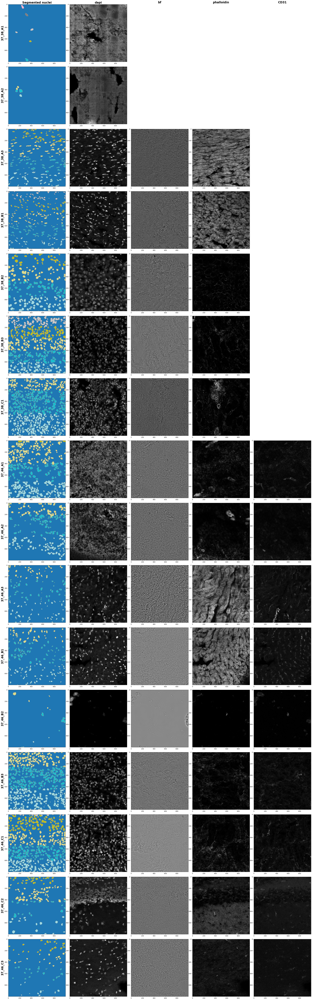

In [44]:
keys = sorted(containers.keys())

nrows = len(keys)
ncols = 5
channels = ["dapi", "bf", "phalloidin", "CD31"]

fig, axs = plt.subplots(nrows, ncols, figsize=(6*ncols, 6*nrows))

for i, key in enumerate(keys):
    image = containers[key]
    
    center = int(image.shape[0] / 2)
    
    # plot segmentation mask
    img = np.array(image['segmented'].squeeze())
    axs[i, 0].imshow(img[center-500:center+500, center-500:center+500], cmap='tab20')
    axs[i, 0].set_ylabel(key, fontsize=20, fontweight='bold')
    
    if i == 0:
        axs[i, 0].set_title("Segmented nuclei", fontsize=20, fontweight='bold')
    
    
    # get channels
    #channels = [elem for elem in list(image) if elem != "segmented"]
    
    for j, ch in enumerate(channels):
        if ch in image:
            img = np.array(image[ch].squeeze())
            axs[i, j+1].imshow(img[center-500:center+500, center-500:center+500], cmap='gray')
            
        else:
            axs[i, j+1].axis('off')
            
        if i == 0:
            axs[i, j+1].set_title(ch, fontsize=20, fontweight='bold')

fig.tight_layout()

plt.savefig("figures/segmentation_example.pdf")

plt.show()  

# Calculate regionprops

In [22]:
binary_cats = ("label", "area", "perimeter", "eccentricity", "centroid", "bbox")
intensity_cats = ("intensity_mean", "intensity_max", "intensity_min", "image_intensity")

In [24]:
regprops = {}

for i, idx in enumerate(indices):
    print("Processing {} ({}/{})".format(idx, i+1, len(indices)))
    
    props = {}
    props["intensity"] = {}
    
    # get image container
    image = containers[idx]
    
    # get label image
    label_img = np.array(image['segmented'].squeeze())

    # calculate binary region props and store them in dictionary
    print("\tCalculating binary regionprops...")
    bin_props = regionprops_table(label_image=label_img, properties=binary_cats)
    props["binary"] = pd.DataFrame(bin_props)

    # get intensity layers
    int_layers = [elem for elem in list(image) if not elem == "segmented"]

    for label in int_layers:
        print("\tCalculating intensity regionprops for {}...".format(label))
        # fetch intensity image
        intensity_img = np.array(image[label].squeeze())

        # calculate intensity dependent regionprops for this channel
        int_props = regionprops_table(label_image=label_img, intensity_image=intensity_img,
                                      properties=intensity_cats)
        props["intensity"][label] = pd.DataFrame(int_props)
        
    regprops[idx] = props

Processing 37_38_A3 (1/16)
	Calculating binary regionprops...
	Calculating intensity regionprops for bf...
	Calculating intensity regionprops for dapi...
	Calculating intensity regionprops for phalloidin...
Processing 37_38_B1 (2/16)
	Calculating binary regionprops...
	Calculating intensity regionprops for bf...
	Calculating intensity regionprops for dapi...
	Calculating intensity regionprops for phalloidin...
Processing 37_38_B2 (3/16)
	Calculating binary regionprops...
	Calculating intensity regionprops for bf...
	Calculating intensity regionprops for dapi...
	Calculating intensity regionprops for phalloidin...
Processing 37_38_B3 (4/16)
	Calculating binary regionprops...
	Calculating intensity regionprops for bf...
	Calculating intensity regionprops for dapi...
	Calculating intensity regionprops for phalloidin...
Processing 37_38_C1 (5/16)
	Calculating binary regionprops...
	Calculating intensity regionprops for bf...
	Calculating intensity regionprops for dapi...
	Calculating inten

# Save features/regionprops

All parameters but the `image_intensity` parameter are stored as `.csv` files. `image_intensity` are images and would need to be stored as `.tif` (not done here)

### Save features without images

To save storage space we first save the features without the images. After filtering we also save the images.

In [180]:
feature_dir = os.path.join(data_dir, "features")
image_dir = os.path.join(feature_dir, "images")

In [46]:
save_images = False

# create feature directory if necessary
Path(feature_dir).mkdir(parents=True, exist_ok=True)

if save_images:
    Path(image_dir).mkdir(parents=True, exist_ok=True)

for idx, props in regprops.items():
    print("Saving {}...".format(idx))
    # save binary regionprops
    savefile = os.path.join(feature_dir, "featureprops-{}-binary.csv".format(idx))
    props['binary'].to_csv(savefile, index=False)
    
    # save intensity based regionprops
    labels = props['intensity'].keys()
    for label in labels:
        print("\t{}".format(label))
        # extract dataframe
        data = props['intensity'][label]
        nfill = len(str(len(data))) # needed for leading zeros later
        
        if save_images:
            # save images
            img_dir = os.path.join(image_dir, "{}-{}".format(idx, label))
            Path(img_dir).mkdir(parents=True, exist_ok=True)
            for i, img in data['image_intensity'].iteritems():
                ii = str(i).zfill(nfill)
                image_file = os.path.join(img_dir, "nucleus-{}-{}-{}.tif".format(idx, label, ii))
                cv2.imwrite(image_file, img)
            
        # save dataframe without image column
        savefile = os.path.join(feature_dir, "featureprops-{}-{}.csv".format(idx, label))
        data.drop('image_intensity', axis=1).to_csv(savefile, index=False)

Saving 37_38_A3...
	bf
	dapi
	phalloidin
Saving 37_38_B1...
	bf
	dapi
	phalloidin
Saving 37_38_B2...
	bf
	dapi
	phalloidin
Saving 37_38_B3...
	bf
	dapi
	phalloidin
Saving 37_38_C1...
	bf
	dapi
	phalloidin
Saving 37_46_A1...
	CD31
	bf
	dapi
	phalloidin
Saving 37_46_A2...
	CD31
	bf
	dapi
	phalloidin
Saving 37_46_A3...
	CD31
	bf
	dapi
	phalloidin
Saving 37_46_B1...
	CD31
	bf
	dapi
	phalloidin
Saving 37_46_B2...
	CD31
	bf
	dapi
	phalloidin
Saving 37_46_B3...
	CD31
	bf
	dapi
	phalloidin
Saving 37_46_C1...
	CD31
	bf
	dapi
	phalloidin
Saving 37_46_C2...
	CD31
	bf
	dapi
	phalloidin
Saving 37_46_C3...
	CD31
	bf
	dapi
	phalloidin
Saving 37_38_A1...
	dapi
Saving 37_38_A2...
	dapi


# Load feature props

In [506]:
feature_dir = os.path.join(data_dir, "features")
feature_files = glob(os.path.join(feature_dir, "*"))

In [507]:
feature_files[:5]

['/lustre/groups/hpc/meier_lab/projects/SpatialMouse/analysis/segmentation/features/featureprops-37_46_A3-dapi.csv',
 '/lustre/groups/hpc/meier_lab/projects/SpatialMouse/analysis/segmentation/features/featureprops-37_46_B1-dapi.csv',
 '/lustre/groups/hpc/meier_lab/projects/SpatialMouse/analysis/segmentation/features/featureprops-37_46_A1-bf.csv',
 '/lustre/groups/hpc/meier_lab/projects/SpatialMouse/analysis/segmentation/features/featureprops-37_46_C1-CD31.csv',
 '/lustre/groups/hpc/meier_lab/projects/SpatialMouse/analysis/segmentation/features/featureprops-37_46_C3-binary.csv']

In [508]:
regprops = {}

for file in feature_files:
    # get informations from file name
    idx = os.path.basename(file).split("-")[1]
    label = os.path.basename(file).split("-")[2].rstrip(".csv")
    
    # read dataframe
    df = pd.read_csv(file)
    
    # check if this index already exists in dictionary
    if idx not in regprops:
        regprops[idx] = {}
        regprops[idx]['intensity'] = {}
    
    if label == 'binary':
        regprops[idx][label] = df
    else:
        regprops[idx]['intensity'][label] = df

## Add segmentation information and featureprops to adata and save

Locations:
- Segmentation masks: `adata.uns['spatial']['id_segmented']['images']['hires']`
- featureprops: `adata.uns['featureprops']`

In [182]:
containers

{'37_46_C3': ImageContainer[shape=(20296, 20296), layers=['CD31', 'bf', 'dapi', 'phalloidin', 'segmented']],
 '37_38_A3': ImageContainer[shape=(20296, 20296), layers=['bf', 'dapi', 'phalloidin', 'segmented']],
 '37_38_B1': ImageContainer[shape=(20296, 20296), layers=['bf', 'dapi', 'phalloidin', 'segmented']],
 '37_46_C1': ImageContainer[shape=(20296, 20296), layers=['CD31', 'bf', 'dapi', 'phalloidin', 'segmented']],
 '37_38_C1': ImageContainer[shape=(20296, 20296), layers=['bf', 'dapi', 'phalloidin', 'segmented']],
 '37_46_B3': ImageContainer[shape=(20296, 20296), layers=['CD31', 'bf', 'dapi', 'phalloidin', 'segmented']],
 '37_46_B2': ImageContainer[shape=(20296, 20296), layers=['CD31', 'bf', 'dapi', 'phalloidin', 'segmented']],
 '37_46_B1': ImageContainer[shape=(20296, 20296), layers=['CD31', 'bf', 'dapi', 'phalloidin', 'segmented']],
 '37_38_A1': ImageContainer[shape=(7608, 7608), layers=['dapi', 'segmented']],
 '37_46_A1': ImageContainer[shape=(20296, 20296), layers=['CD31', 'bf', '

In [201]:
# add segmented images to adata
for idx, image in containers.items():
    # get scalefactors for this id from dapi image
    sf = hq_adata.uns['spatial']['{}_dapi'.format(idx)]['scalefactors']
    
    # generate image dictionary for segmented image
    img_dict = {}
    img_dict['scalefactors'] = sf
    img_dict['images'] = {}
    img_dict['images']['hires'] = np.array(image['segmented'].squeeze())
    
    # add image dictionary to adata
    hq_adata.uns['spatial']['{}_segmented'.format(idx)] = img_dict

#### Save adata with segmented images !!! ATTENTION: Since for the segmentation masks we need 32bit integers the resulting file is very big!

In [212]:
adata_seg_file = "/lustre/groups/hpc/meier_lab/projects/SpatialMouse/analysis/adata_filtered_unnormalized_hqimages_segmented.h5ad"

hq_adata.write(adata_seg_file)

In [216]:
hq_adata.uns['spatial'].keys()

dict_keys(['37_38_A1_dapi', '37_38_A2_dapi', '37_38_A3_bf', '37_38_A3_dapi', '37_38_A3_phalloidin', '37_38_B1_bf', '37_38_B1_dapi', '37_38_B1_phalloidin', '37_38_B2_bf', '37_38_B2_dapi', '37_38_B2_phalloidin', '37_38_B3_bf', '37_38_B3_dapi', '37_38_B3_phalloidin', '37_38_C1_bf', '37_38_C1_dapi', '37_38_C1_phalloidin', '37_46_A1_CD31', '37_46_A1_bf', '37_46_A1_dapi', '37_46_A1_phalloidin', '37_46_A2_CD31', '37_46_A2_bf', '37_46_A2_dapi', '37_46_A2_phalloidin', '37_46_A3_CD31', '37_46_A3_bf', '37_46_A3_dapi', '37_46_A3_phalloidin', '37_46_B1_CD31', '37_46_B1_bf', '37_46_B1_dapi', '37_46_B1_phalloidin', '37_46_B2_CD31', '37_46_B2_bf', '37_46_B2_dapi', '37_46_B2_phalloidin', '37_46_B3_CD31', '37_46_B3_bf', '37_46_B3_dapi', '37_46_B3_phalloidin', '37_46_C1_CD31', '37_46_C1_bf', '37_46_C1_dapi', '37_46_C1_phalloidin', '37_46_C2_CD31', '37_46_C2_bf', '37_46_C2_dapi', '37_46_C2_phalloidin', '37_46_C3_CD31', '37_46_C3_bf', '37_46_C3_dapi', '37_46_C3_phalloidin', '37_46_C3_segmented', '37_38_A3_

### Since the adata becomes very large with the segmentation masks already I decided to not add the featureprops to adata and instead save them separately as `.csv` as shown above.

## Distribution of cell size per sample

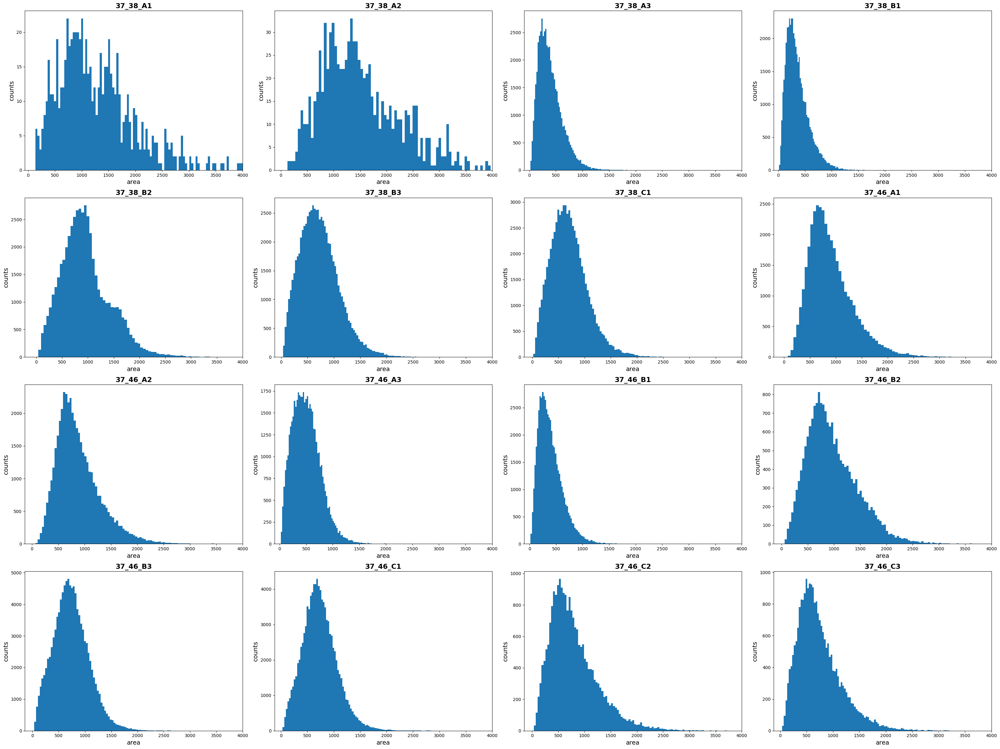

In [98]:
ncols = 4
nrows = 4
nbins = 100
cat = 'area'
xmax = 4000

fig, axs = plt.subplots(nrows,ncols,figsize=(8*ncols, 6*nrows))

axs = axs.ravel()

keys = sorted(regprops.keys())

for i, idx in enumerate(keys):
    # get data
    data = regprops[idx]['binary']
    counts = data[cat]
    
    # plotting
    axs[i].hist(counts, bins=nbins)
    axs[i].set_title(idx, fontsize=16, fontweight='bold')
    axs[i].set_xlabel(cat, fontsize=14)
    axs[i].set_ylabel('counts', fontsize=14)
    axs[i].set_xlim(None, xmax)
    
    # add threshold
    #axs[i].axvline(db.tl.otsu_threshold(data[cat]), color='red')
    #axs[i].axvline(np.average(counts) * 2, color='red', linewidth=4)
    
fig.tight_layout()

plt.savefig("figures/segmentation_histogram_area.pdf")

plt.show()

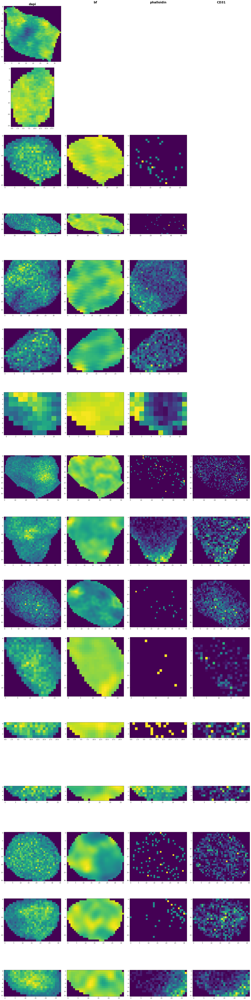

In [97]:
keys = sorted(regprops.keys())

nrows = len(keys)
ncols = 4
channels = ["dapi", "bf", "phalloidin", "CD31"]

fig, axs = plt.subplots(nrows, ncols, figsize=(6*ncols, 6*nrows))

for i, key in enumerate(keys):
    props = regprops[key]['intensity']    
    
    # get channels
    #channels = [elem for elem in list(image) if elem != "segmented"]
    
    for j, ch in enumerate(channels):
        if ch in props:
            img = props[ch]['image_intensity'][0]
            axs[i, j].imshow(img, cmap='viridis')
            
        else:
            axs[i, j].axis('off')
            
        if i == 0:
            axs[i, j].set_title(ch, fontsize=20, fontweight='bold')

fig.tight_layout()

plt.savefig("figures/segmentation_example_nuclei.pdf")

plt.show()  

### Distribution of roundness

In [54]:
def roundness(area, perimeter):
    import math
    return 4 * math.pi * area / (perimeter**2)

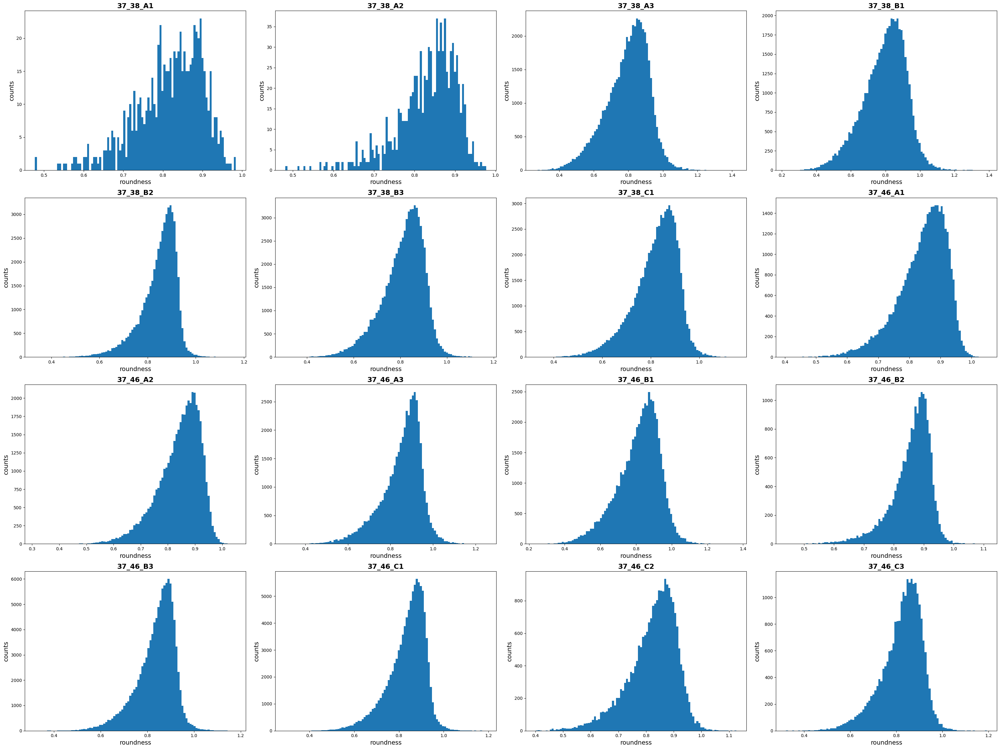

In [ ]:
ncols = 4
nrows = 4
nbins = 100
cat = 'roundness'
xmax = None

fig, axs = plt.subplots(nrows,ncols,figsize=(8*ncols, 6*nrows))

axs = axs.ravel()

keys = sorted(regprops.keys())

for i, idx in enumerate(keys):
    # get data
    data = regprops[idx]['binary']
    data["roundness"] = [roundness(a, p) for a, p in zip(data['area'], data['perimeter'])]
    counts = data[cat]
    
    # plotting
    axs[i].hist(counts, bins=nbins)
    axs[i].set_title(idx, fontsize=16, fontweight='bold')
    axs[i].set_xlabel(cat, fontsize=14)
    axs[i].set_ylabel('counts', fontsize=14)
    axs[i].set_xlim(None, xmax)
    
    # add threshold
    #axs[i].axvline(db.tl.otsu_threshold(data[cat]), color='red')
    #axs[i].axvline(np.average(counts) / 2, color='red', linewidth=4)
    
fig.tight_layout()

plt.savefig("figures/segmentation_histogram_{}.pdf".format(cat))

plt.show()

### Plot nucleus with minimum roundness

In [81]:
k = '37_46_A3'
props = regprops[k]

i = props['binary'].sort_values('roundness').index[0]
img = props['intensity']['dapi']['image_intensity'][i]

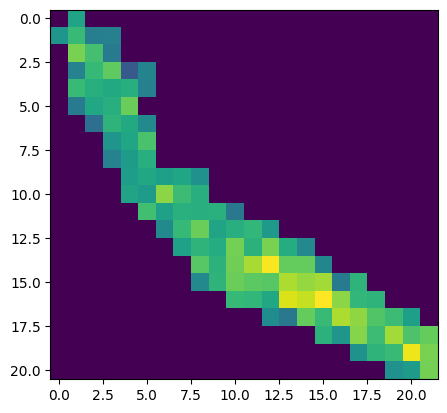

In [82]:
plt.imshow(img)

## Filtering

### Summary of previous sections:
1. Segmentation works very well if the nuclei are segmentable
    - For some samples like spleen they are often too crowded or too destroyed if we do not have the hq data. Also brain is too crowded in some parts.
2. Also small fragments seem to be derived from real nuclei
3. Bigger problem is an under segmentation.
    - to remove nuclei that are too big we could remove nuclei that are too large. However, this would result in an even lower accuracy when we calculate the number of nuclei per spot e.g.
4. Other measure would be roundness.
    - However, in some organs the nuclei are very long (see Heart above). And there a low roundness does not give a good criteria to filter.
    
### Conclusion
- I decided to not do any filtering on the nuclei segmentation and just take them as predicted from cellpose.

## Distribution of CD31 signal

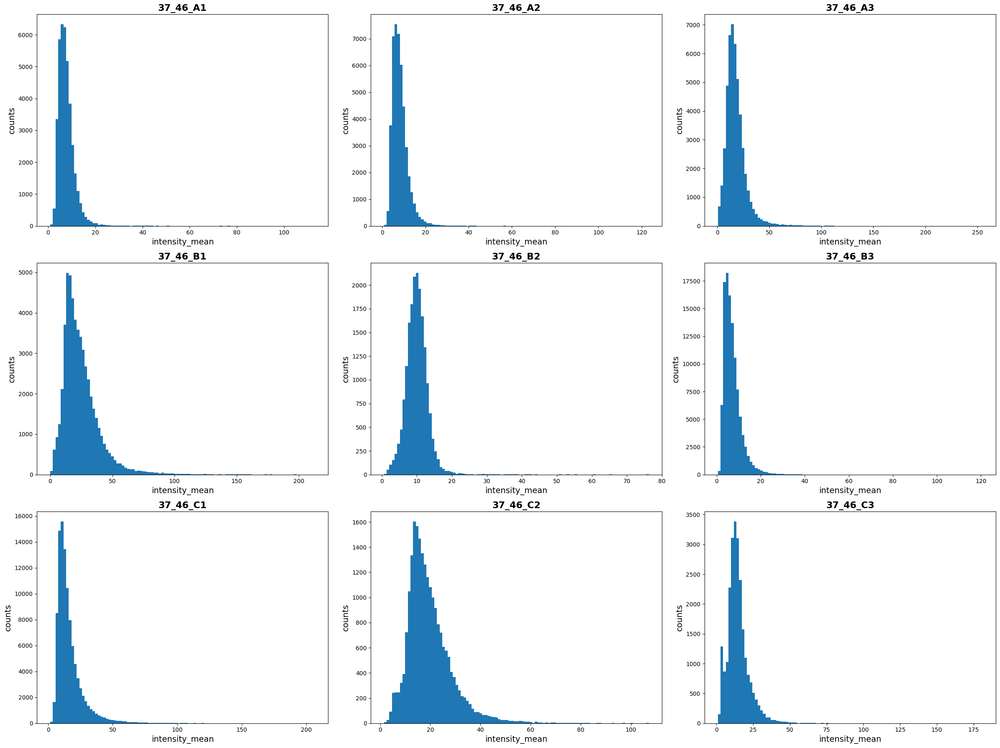

In [113]:
ncols = 3
nrows = 3
nbins = 100
cat = 'intensity_mean'
channel = 'CD31'
xmax = None

fig, axs = plt.subplots(nrows,ncols,figsize=(8*ncols, 6*nrows))

axs = axs.ravel()

keys = [k for k in sorted(regprops.keys()) if k.startswith("37_46")]

for i, idx in enumerate(keys):
    # get data
    data = regprops[idx]['intensity'][channel]
    counts = data[cat]
    
    # plotting
    axs[i].hist(counts, bins=nbins)
    axs[i].set_title(idx, fontsize=16, fontweight='bold')
    axs[i].set_xlabel(cat, fontsize=14)
    axs[i].set_ylabel('counts', fontsize=14)
    axs[i].set_xlim(None, xmax)
    
    # add threshold
    #axs[i].axvline(db.tl.otsu_threshold(data[cat]), color='red')
    #axs[i].axvline(np.average(counts) / 2, color='red', linewidth=4)
    
fig.tight_layout()

#plt.savefig("figures/segmentation_histogram_{}.pdf".format(cat))

plt.show()

## Get regionprops in surrounding of nuclei

In [116]:
indices = [i for i in sorted(containers.keys()) if i.startswith("37_46")]

In [117]:
indices

['37_46_A1',
 '37_46_A2',
 '37_46_A3',
 '37_46_B1',
 '37_46_B2',
 '37_46_B3',
 '37_46_C1',
 '37_46_C2',
 '37_46_C3']

In [15]:
image = containers["37_46_C1"]

In [16]:
intensity_img = np.array(image['CD31'].squeeze()) 

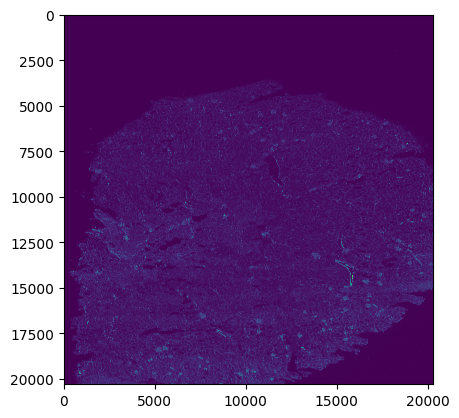

In [17]:
plt.imshow(intensity_img)
plt.show()

In [28]:
crop = image.crop_center(19000, 4700, radius=300)

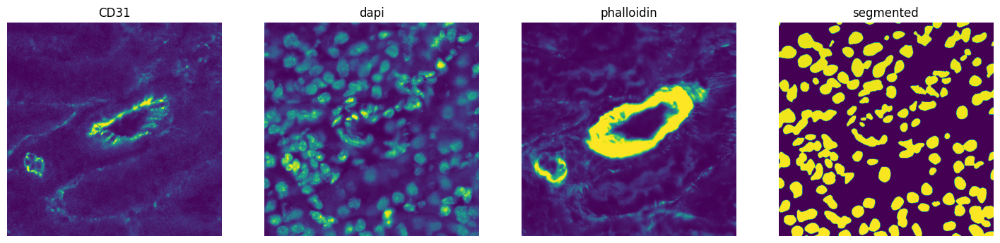

In [39]:
fig, axs = plt.subplots(1, 4, figsize=(6*3, 6))
crop.show(layer='CD31', ax=axs[0])
crop.show(layer='dapi', ax=axs[1])
crop.show(layer='phalloidin', ax=axs[2])
crop.show(layer='segmented', ax=axs[3])

In [40]:
label_img = np.array(crop['segmented'].squeeze()) 

In [44]:
intensity_img = np.array(crop['CD31'].squeeze())

In [148]:
binary_cats = ("label", "area", "perimeter", "eccentricity", "centroid", "bbox", "equivalent_diameter_area")
intensity_cats = ("intensity_mean", "intensity_max", "intensity_min", "image_intensity")

In [149]:
props = regionprops(label_image=label_img, intensity_image=intensity_img)
ptable = pd.DataFrame(regionprops_table(label_image=label_img, intensity_image=intensity_img, properties=binary_cats))

In [185]:
feat = ptable.iloc[20, :]

In [505]:
def dilate_feature(img, radius):
    kernel = np.ones((radius,radius),np.uint8)
    
    dilated = cv2.dilate(img.astype('uint8'), kernel=kernel)
    return dilated

def get_proximity_signal(featprops, label_img, intensity_img, proxradius=40, return_all=False):
    l=int(featprops['label'])
    r=int(featprops['centroid-0'])
    c=int(featprops['centroid-1'])
    radius=proxradius * 2

    # get edges 
    rmin = r-radius
    rmax = r+radius
    cmin = c-radius
    cmax = c+radius

    # assure that the min values are not negative
    if rmin < 0:
        rmin = 0
    if cmin < 0:
        cmin = 0

    detail = label_img[rmin:rmax, cmin:cmax]
    signal_img = intensity_img[rmin:rmax, cmin:cmax]
        
    # extract mask with correct label
    detail = detail == l

    # determine the radius from the size of the nucleus
    #radius = int(feat['equivalent_diameter_area'])

    # dilate the binary mask
    dilated = dilate_feature(detail, radius=proxradius)
        
    # get binary mask of surrounding
    proximity = (dilated & ~detail).astype(bool)
    
    if return_all:
        # return (1) signal in proximity, (2) mask of proximity region and (3) image of the whole signal
        return signal_img[proximity], proximity, signal_img
    else:
        # return only the signal in the proximity
        return signal_img[proximity]

## Extract proximity signal

In [509]:
#key = "37_46_C3"
channels_to_measure = ["phalloidin", "CD31"]
proxradius = 40

for key in sorted(regprops.keys()):
    print("Processing {}:".format(key))
    # select binary properties for this section
    binprops = regprops[key]['binary']
    label_img = np.array(containers[key]['segmented'].squeeze())

    # get the channels for this key and select the ones to measure
    allchannels = list(regprops[key]['intensity'].keys())
    channels = [c for c in allchannels if c in channels_to_measure]
    
    if len(channels) == 0:
        print("None of the channels {} of this key are in the list `channels_to_measure` {}".format(allchannels, channels_to_measure))

    #ch = "CD31"
    for ch in channels:
        print("\t{}".format(ch))
        intprops = regprops[key]['intensity'][ch]
        intensity_img = np.array(containers[key][ch].squeeze())

        assert len(intprops) == len(binprops), \
            "Intensity properties {} and binary properties {} do not have the same length.".format(len(intprops), len(binprops))

        # iterate through features and calculate signal inside proxradius
        signals = []
        proxmasks = []
        signal_imgs = []
        for i, featprops in binprops.iterrows():
            signal, proxmask, signal_img = get_proximity_signal(featprops=featprops,
                                                                     label_img=label_img,
                                                                     intensity_img=intensity_img, 
                                                                     proxradius=proxradius,
                                                                     return_all=True)
            signals.append(signal)
            proxmasks.append(proxmask)
            signal_imgs.append(signal_img)
            
        #signals.append(signal)

        # calculate mean, max, min of signals and add to intensityprops
        # intprops['mean_proximity'] = [np.average(signal) for signal in signals]
        # intprops['sum_proximity'] = [np.sum(signal) for signal in signals]
        # intprops['area_proximity'] = [len(signal) for signal in signals]
        # intprops['max_proximity'] = [np.max(signal) for signal in signals]
        # intprops['min_proximity'] = [np.min(signal) for signal in signals]
        intprops['proximity_signal'] = signals
        intprops['proximity_mask'] = proxmasks
        intprops['signal_image'] = signal_imgs

Processing 37_38_A1:
None of the channels ['dapi'] of this key are in the list `channels_to_measure` ['phalloidin', 'CD31']
Processing 37_38_A2:
None of the channels ['dapi'] of this key are in the list `channels_to_measure` ['phalloidin', 'CD31']
Processing 37_38_A3:
	phalloidin
Processing 37_38_B1:
	phalloidin
Processing 37_38_B2:
	phalloidin
Processing 37_38_B3:
	phalloidin
Processing 37_38_C1:
	phalloidin
Processing 37_46_A1:
	CD31
	phalloidin
Processing 37_46_A2:
	CD31
	phalloidin
Processing 37_46_A3:
	phalloidin
	CD31
Processing 37_46_B1:
	CD31
	phalloidin
Processing 37_46_B2:
	CD31
	phalloidin
Processing 37_46_B3:
	CD31
	phalloidin
Processing 37_46_C1:
	CD31
	phalloidin
Processing 37_46_C2:
	CD31
	phalloidin
Processing 37_46_C3:
	phalloidin
	CD31


## Calculate parameters from proximity signals

In [557]:
signal_label = "proximity_signal"

for key in sorted(regprops.keys()):
    print("Processing {}".format(key))
    
    #intprops = regprops[key]['intensity']
    channels = list(regprops[key]['intensity'].keys())
    
    for ch in channels:
        intprops = regprops[key]['intensity'][ch]
        if signal_label in intprops.columns:
            print("\t{}: Calculating...".format(ch))
            signals = intprops[signal_label]
            
            # calculate statistics
            intprops['proximity_mean'] = [np.average(signal) for signal in signals]
            intprops['proximity_sum'] = [np.sum(signal) for signal in signals]
            intprops['proximity_area'] = [len(signal) for signal in signals]
            # problem with the calculation of max values - gives negative values in some cases which caould not be explained!
            #intprops['max_proximity'] = [np.max(signal) for signal in signals] 
            intprops['proximity_min'] = [np.min(signal) for signal in signals]
        else:
            print("\t{}: Label `{}` not found in column headers.".format(ch, signal_label))

Processing 37_38_A1
	dapi: Label `proximity_signal` not found in column headers.
Processing 37_38_A2
	dapi: Label `proximity_signal` not found in column headers.
Processing 37_38_A3
	bf: Label `proximity_signal` not found in column headers.
	phalloidin: Calculating...
	dapi: Label `proximity_signal` not found in column headers.
Processing 37_38_B1
	dapi: Label `proximity_signal` not found in column headers.
	bf: Label `proximity_signal` not found in column headers.
	phalloidin: Calculating...
Processing 37_38_B2
	bf: Label `proximity_signal` not found in column headers.
	phalloidin: Calculating...
	dapi: Label `proximity_signal` not found in column headers.
Processing 37_38_B3
	dapi: Label `proximity_signal` not found in column headers.
	bf: Label `proximity_signal` not found in column headers.
	phalloidin: Calculating...
Processing 37_38_C1
	phalloidin: Calculating...
	dapi: Label `proximity_signal` not found in column headers.
	bf: Label `proximity_signal` not found in column headers

## Scatterplot of CD31 and Phalloidin per nucleus

In [600]:
key = "37_46_C1"
keys = [elem for elem in regprops.keys() if elem.startswith("37_46")]

signaldata = {}
for key in keys:
    data = pd.DataFrame(
    {
        "label": regprops[key]['binary']['label'],
        "CD31": regprops[key]['intensity']['CD31']['proximity_mean'],
        "Phalloidin": regprops[key]['intensity']['phalloidin']['proximity_mean']
    })
    signaldata[key] = data

signaldata = pd.concat(signaldata)
signaldata = signaldata.reset_index(level=0).rename(columns={'level_0': 'id'}).sort_values(['id', 'label'])

# MinMax normalize data
normdata = signaldata[["id", "CD31", "Phalloidin"]].groupby('id').transform(lambda x: (x - x.min()) / (x.max() - x.min()))
normdata.columns = [elem + "_norm" for elem in normdata.columns]
signaldata = pd.concat([signaldata, normdata], axis=1)

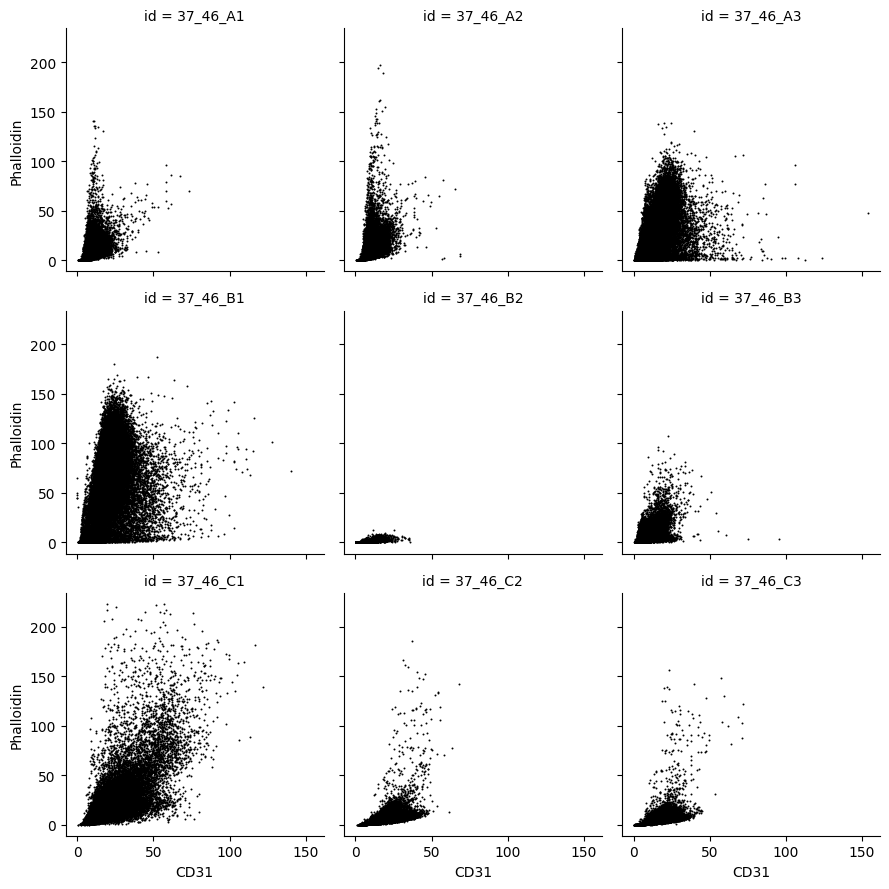

In [602]:
g = sns.FacetGrid(signaldata, col="id", col_wrap=3)
g.map(sns.scatterplot, "CD31", "Phalloidin", s=2, color='k', linewidth=0)

plt.show()

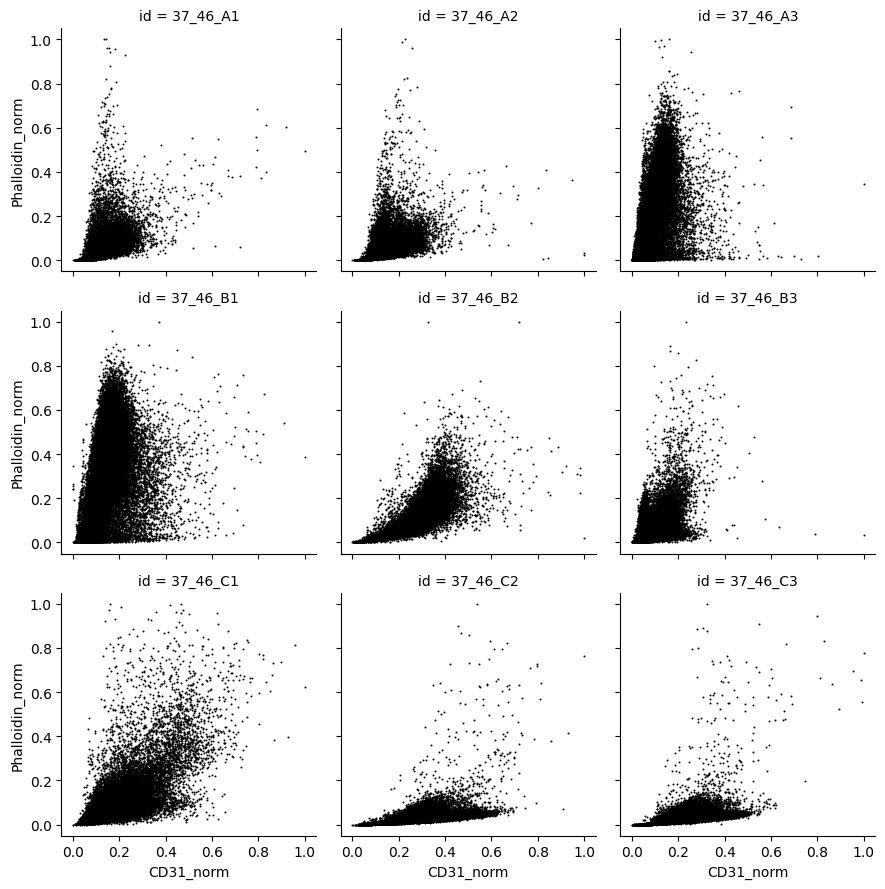

In [603]:
g = sns.FacetGrid(signaldata, col="id", col_wrap=3)
g.map(sns.scatterplot, "CD31_norm", "Phalloidin_norm", s=2, color='k', linewidth=0)

plt.show()

## Check out most promising clusters

Let's start with `37_46_C1`

In [609]:
import random

In [764]:
key = "37_46_C1"
CD31_thresh = 0.3
phal_thresh = 0.3

# select data
image = containers[key]
data = signaldata.query('id == "{}"'.format(key))
selected = data.query('CD31_norm > {} & Phalloidin_norm > {}'.format(CD31_thresh, phal_thresh))

selected = selected.reset_index().drop('index', axis=1)

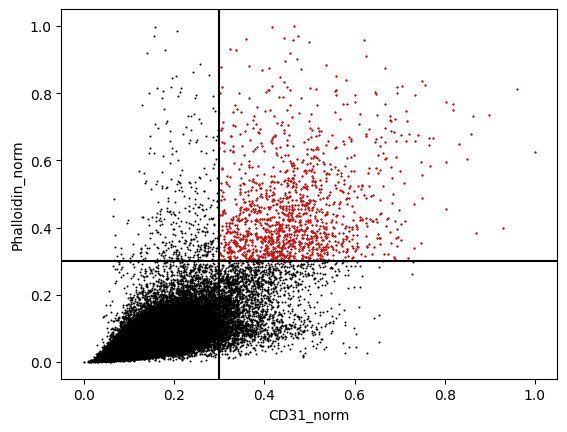

In [765]:
sns.scatterplot(data=data, x="CD31_norm", y="Phalloidin_norm", s=2, color='k', linewidth=0)
sns.scatterplot(data=selected, x="CD31_norm", y="Phalloidin_norm", s=2, color='r', linewidth=0)
plt.axvline(CD31_thresh, c='k')
plt.axhline(phal_thresh, c='k')

In [766]:
n = 5
random.seed(0)
idx_sample = random.sample(range(1, len(selected)), n)

label_sample = selected.iloc[idx_sample, :]['label'].values

In [767]:
intprops = regprops[key]['intensity']
binprops = regprops[key]['binary']

In [768]:
# select sampled labels
feats = binprops.loc[binprops['label'].isin(label_sample),:]

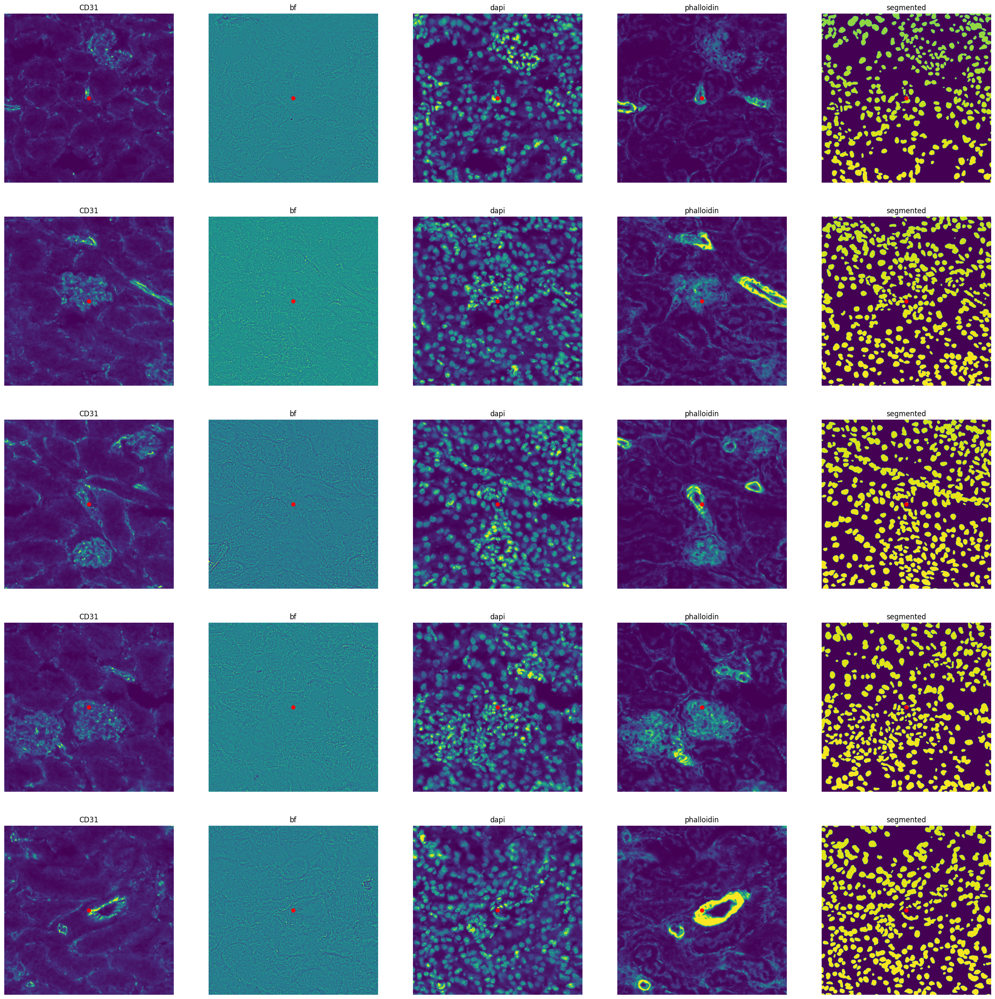

In [769]:
radius = 500

channels = list(image)

fig, axs = plt.subplots(n, len(channels), figsize=(6*len(channels), 6*n))

for r, (i, feat) in enumerate(feats.iterrows()):
    rr = int(feat['centroid-0'])
    cc = int(feat['centroid-1'])
    
    for c, ch in enumerate(channels):
        crop = image.crop_center(rr, cc, radius=radius)
        crop.show(layer=ch, ax=axs[r,c])
        
        axs[r,c].scatter(radius, radius, color='r')

## Show all selected nuclei as points on image

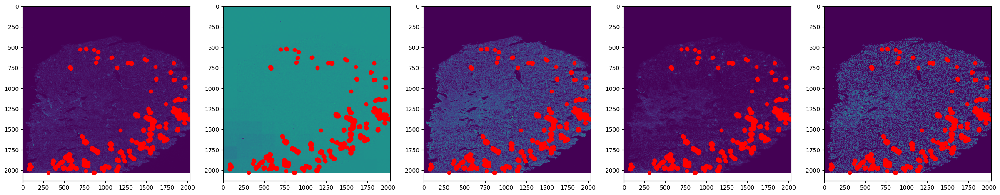

In [770]:
labels_selected = selected['label'].values

# select sampled labels
feats = binprops.loc[binprops['label'].isin(labels_selected),:]

# plotting of image and nuclei as points
channels = list(image)
x = feats['centroid-1']
y = feats['centroid-0']
sf = 0.1

fig, axs = plt.subplots(1,len(channels),figsize=(6*len(channels),6))

for c, ch in enumerate(channels):
    img = np.array(image[ch].squeeze())
    
    if img.dtype is not np.dtype('uint8'):
        img = img.astype('uint8')
    
    if sf < 1:
        img = db.im.resize_image(img, sf)
    #image.show(layer=ch, ax=axs[c])
    axs[c].imshow(img)
    axs[c].scatter(x*sf, y*sf, color='r')
    
plt.show()

## Problem: Unequal illumination

### Solution

Correction using the `Pseudo flatfield correction` tool in the `Biovoxxel` suite of ImageJ.

Here I corrected the image with a blurring radius of 5000.

In [773]:
ffc_file = "/lustre/groups/hpc/meier_lab/projects/SpatialMouse/analysis/images/pseudoffc/37_46_firstimaging_13x13_10%_2021_12_09__10_25_51-Scene-01_c2ffc2000_stitched_flipped.tif"

In [780]:
ffc = cv2.imread(ffc_file, 0) # load as grayscale

In [781]:
ffc

array([[ 9,  1,  0, ...,  0,  0,  0],
       [20,  0,  9, ...,  0,  0,  0],
       [ 6,  0,  1, ...,  0,  0,  0],
       ...,
       [ 0,  0,  0, ...,  0,  1,  0],
       [ 0,  0,  0, ...,  0,  0,  1],
       [ 0,  0,  0, ...,  0,  0,  0]], dtype=uint8)

# Idea for vessel center identification

## How can we group the endothelial cells and get the center of a vessel?

### Idea 1
1. Define a minimum size and maximum distance of a endothelial cells that defines a cluster
2. Identify such clusters of endothelial cells
3. Calculate centroid of the centroids of these clusters of endothelial cells.

### Idea 2
1. Select cells with enough phalloidin/CD31 expression
2. Cluster them based on their overall location in the tissue using a clustering alogrithm like DBSCAN, etc. (something that doesn't need to know the number of clusters)

In [618]:
selected['label'].max()

100342

In [615]:
list(range(0, 10))

[0, 1, 2, 3, 4, 5, 6, 7, 8, 9]

In [608]:
selected

,id,label,CD31,Phalloidin,CD31_norm,Phalloidin_norm
703,37_46_A1,704,58.081467,78.634859,0.789220,0.557305
709,37_46_A1,710,58.445165,96.545876,0.794178,0.684248
5419,37_46_A1,5420,45.970916,77.558787,0.624120,0.549679
7645,37_46_A1,7646,67.593555,85.022869,0.918896,0.602580
7710,37_46_A1,7711,61.351456,86.563524,0.833799,0.613499
...,...,...,...,...,...,...
20615,37_46_C3,20616,62.163782,99.675000,0.864886,0.637633
20620,37_46_C3,20621,57.497949,147.699231,0.799741,0.944853
20654,37_46_C3,20655,47.353206,80.677461,0.658097,0.516102
20657,37_46_C3,20658,59.658761,129.650000,0.829910,0.829389
